Spatial-temporal analysis of travel patterns

In [1]:
import requests
import pandas as pd
import numpy as np

from bs4 import BeautifulSoup
import zipfile
import os

import pyarrow.parquet as pq
import seaborn as sns
import contextily as ctx
import matplotlib.pyplot as plt
from PIL import Image

import geopandas as gpd
from shapely.geometry import Point, Polygon, LineString
import geoplot
import mapclassify as mc
import folium
from folium.plugins import HeatMap

import warnings
# Ignore warning messages
warnings.filterwarnings('ignore')

In [2]:
bike_final = pd.read_csv("bike_final.csv")
bike_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5712065 entries, 0 to 5712064
Data columns (total 29 columns):
 #   Column                     Dtype  
---  ------                     -----  
 0   started_at                 object 
 1   ended_at                   object 
 2   start_station_name         object 
 3   end_station_name           object 
 4   lat_start                  float64
 5   lng_start                  float64
 6   lat_end                    float64
 7   lng_end                    float64
 8   Year                       int64  
 9   Month                      int64  
 10  Season                     int64  
 11  DayofMonth                 int64  
 12  DayofWeek                  int64  
 13  Is_weekend                 int64  
 14  Hour                       int64  
 15  Ride_Duration              int64  
 16  Ride_Duration_Category     int64  
 17  Ride_distance_km           float64
 18  Ride_distance_category     int64  
 19  nearest_distance_km        float64
 20  ne

Study area and bike-sharing station distribution

In [16]:
#chicago city boundary
chicago=gpd.read_file('raw data/Chicago_CityBoundary/geo_export_9364be01-19fc-4f28-8f1f-64a1c42e8a42.shp')
chicago = chicago.to_crs(epsg =4326)

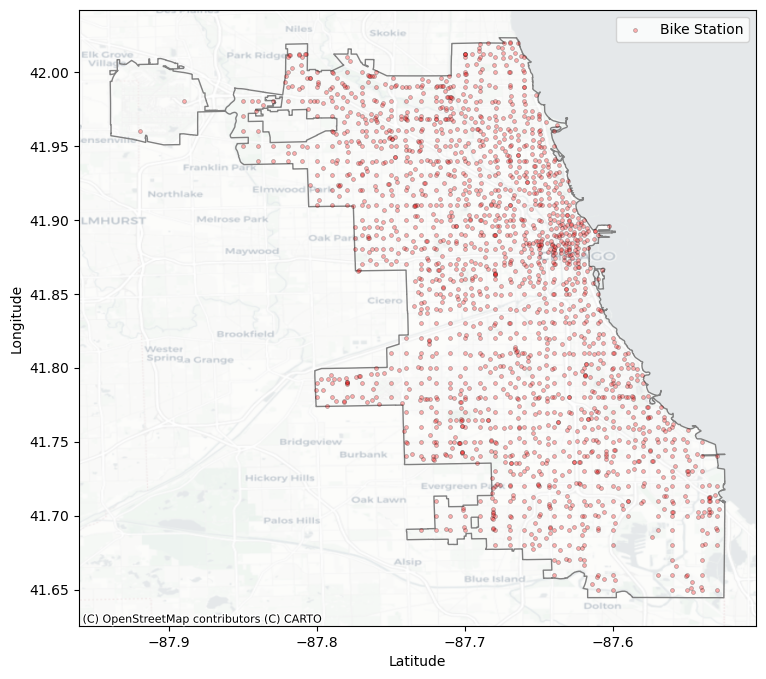

In [19]:
# Fig. 1. Study area and bike-sharing station distribution
# read data
BikeStation_distribution = pd.read_csv("preprocessing process data/stations_inner_nearest.csv")
BikeStation_distribution = BikeStation_distribution.iloc[:, [0, 1,2]].copy()

#creating geodataframe
BikeStation_distribution_gdf = gpd.GeoDataFrame(
    BikeStation_distribution, geometry=gpd.points_from_xy(BikeStation_distribution['lng'], BikeStation_distribution['lat']))
BikeStation_distribution_gdf.set_crs(epsg=4326, inplace=True)

#
fig, ax = plt.subplots(figsize=(12, 8))
# Plot the data
chicago.plot(ax=ax, edgecolor='gray', linewidth=1, facecolor='none')
BikeStation_distribution_gdf.plot(ax=ax, 
                         markersize=8, color='red', alpha=0.3,
                         edgecolor='black', linewidth=0.5,
                         label='Bike Station')    
# Set graphic properties
ax.set_xlabel('Latitude')
ax.set_ylabel('Longitude')
ax.legend()
# Add basemap
ctx.add_basemap(ax, crs="EPSG:4326", source=ctx.providers.CartoDB.Positron, alpha=0.6)
# Adjustment of legend and layout
plt.tight_layout()
# Save image
plt.savefig('figure/Fig 1', dpi=300)
plt.show()

Riding distance and duration

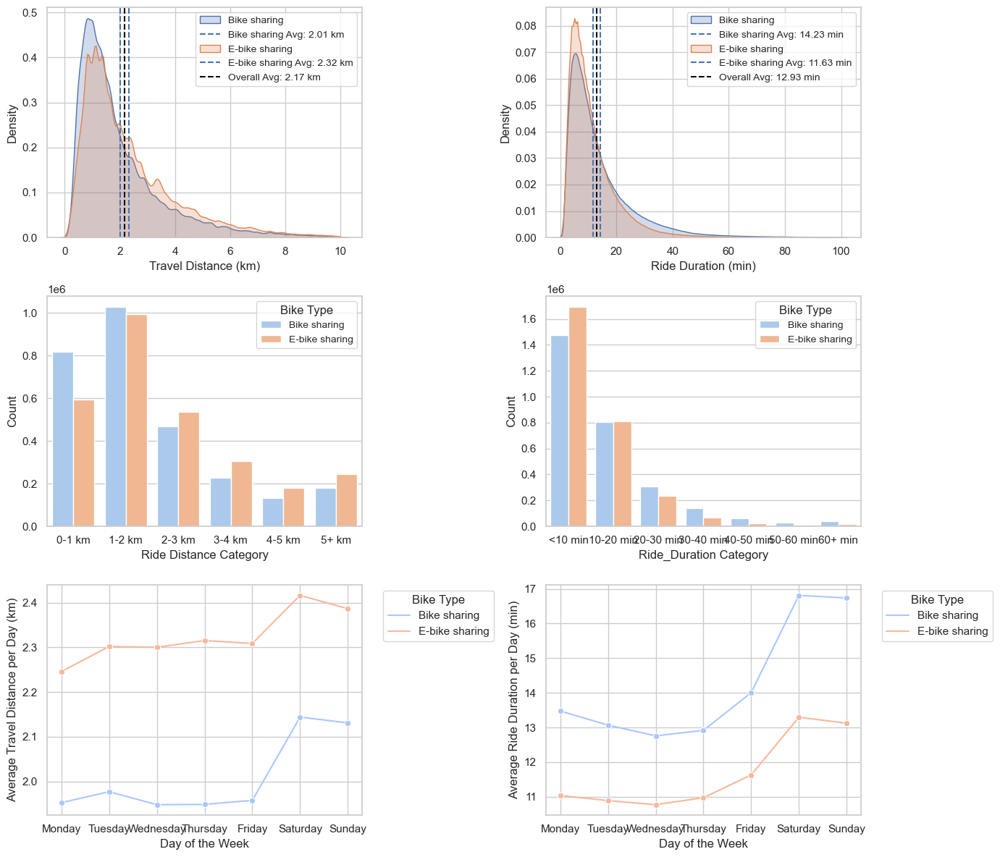

In [96]:
# read data
selected_columns = list(range(8, 19)) + [28]
dis_dur = bike_final.iloc[:,selected_columns]
dis_dur['is_Ebike'] = dis_dur['is_Ebike'].map({0: 'Bike sharing', 1: 'E-bike sharing'})

sns.set(style="whitegrid")
fig, axes = plt.subplots(3, 2, figsize=(14, 12))

# Density maps of travel distance/duration distribution for total and different bike types
for bike_type in dis_dur['is_Ebike'].unique():
    subset = dis_dur[dis_dur['is_Ebike'] == bike_type]
    sns.kdeplot(data=subset['Ride_distance_km'], shade=True, label=bike_type, ax=axes[0, 0])
    # Calculation of average travel distance
    mean_distance = subset['Ride_distance_km'].mean()
    axes[0, 0].axvline(mean_distance, linestyle='--', label=f'{bike_type} Avg: {mean_distance:.2f} km')    
# Calculate the overall average travel distance
mean_distance_all = dis_dur['Ride_distance_km'].mean()
axes[0, 0].axvline(mean_distance_all, color='black', linestyle='--', label=f'Overall Avg: {mean_distance_all:.2f} km')
# Set title and labels
axes[0, 0].set_xlabel('Travel Distance (km)')
axes[0, 0].set_ylabel('Density')
axes[0, 0].legend(fontsize='small', title_fontsize='medium')

for bike_type in dis_dur['is_Ebike'].unique():
    subset = dis_dur[dis_dur['is_Ebike'] == bike_type]
    sns.kdeplot(data=subset['Ride_Duration'], shade=True, label=bike_type, ax=axes[0, 1])
    # Calculation of average travel duration
    mean_duration = subset['Ride_Duration'].mean()
    axes[0, 1].axvline(mean_duration, linestyle='--', label=f'{bike_type} Avg: {mean_duration:.2f} min')
# Calculate the overall average travel duration
mean_duration_all = dis_dur['Ride_Duration'].mean()
axes[0, 1].axvline(mean_duration_all, color='black', linestyle='--', label=f'Overall Avg: {mean_duration_all:.2f} min')
# Set title and labels
axes[0, 1].set_xlabel('Ride Duration (min)')
axes[0, 1].set_ylabel('Density')
axes[0, 1].legend(fontsize='small', title_fontsize='medium')

# Count of rides by Travel distance/duration category
sns.countplot(x='Ride_distance_category',hue='is_Ebike', data=dis_dur, palette='pastel', ax=axes[1, 0])
dis_category = {0: '0-1 km',1: '1-2 km',2: '2-3 km',3: '3-4 km',4: '4-5 km',5: '5+ km'}
axes[1, 0].set_xticklabels(dis_category.values())
axes[1, 0].set_xlabel('Ride Distance Category')
axes[1, 0].set_ylabel('Count')
axes[1, 0].legend(title="Bike Type", fontsize='small', title_fontsize='medium')

sns.countplot(x='Ride_Duration_Category',hue='is_Ebike', data=dis_dur, palette='pastel', ax=axes[1, 1])
dur_category = {0: '<10 min',1: '10-20 min',2: '20-30 min',3: '30-40 min',4: '40-50 min',5: '50-60 min',6: '60+ min'}
axes[1, 1].set_xticklabels(dur_category.values())
axes[1, 1].set_xlabel('Ride_Duration Category')
axes[1, 1].set_ylabel('Count')
axes[1, 1].legend(title="Bike Type", fontsize='small', title_fontsize='medium')

# Average travel distance/duration by day of week
dayofweek_category = {1: 'Monday', 2: 'Tuesday', 3: 'Wednesday', 4: 'Thursday', 
                      5: 'Friday', 6: 'Saturday', 7: 'Sunday'}
sns.lineplot(x='DayofWeek', y='Ride_distance_km', hue='is_Ebike', data=dis_dur, ax=axes[2, 0], 
             ci=None, estimator=np.mean, palette='coolwarm', marker='o')
axes[2, 0].set_xticks(range(1, 8))  # Assumes 'DayofWeek' is in [1, 7]
axes[2, 0].set_xticklabels([dayofweek_category.get(day) for day in range(1, 8)])
axes[2, 0].set_ylabel('Average Travel Distance per Day (km)')
axes[2, 0].set_xlabel('Day of the Week')
axes[2, 0].legend(title="Bike Type", bbox_to_anchor=(1.05, 1), loc='upper left')

sns.lineplot(x='DayofWeek', y='Ride_Duration', hue='is_Ebike', data=dis_dur, ax=axes[2, 1], 
             ci=None, estimator=np.mean, palette='coolwarm', marker='o')
axes[2, 1].set_xticks(range(1, 8))  # Assumes 'DayofWeek' is in [1, 7]
axes[2, 1].set_xticklabels([dayofweek_category.get(day) for day in range(1, 8)])
axes[2, 1].set_ylabel('Average Ride Duration per Day (min)')
axes[2, 1].set_xlabel('Day of the Week')
axes[2, 1].legend(title="Bike Type", bbox_to_anchor=(1.05, 1), loc='upper left')


plt.tight_layout()
plt.savefig('figure/Fig 2.png', dpi=300)
plt.show()

Time Travel Characteristics

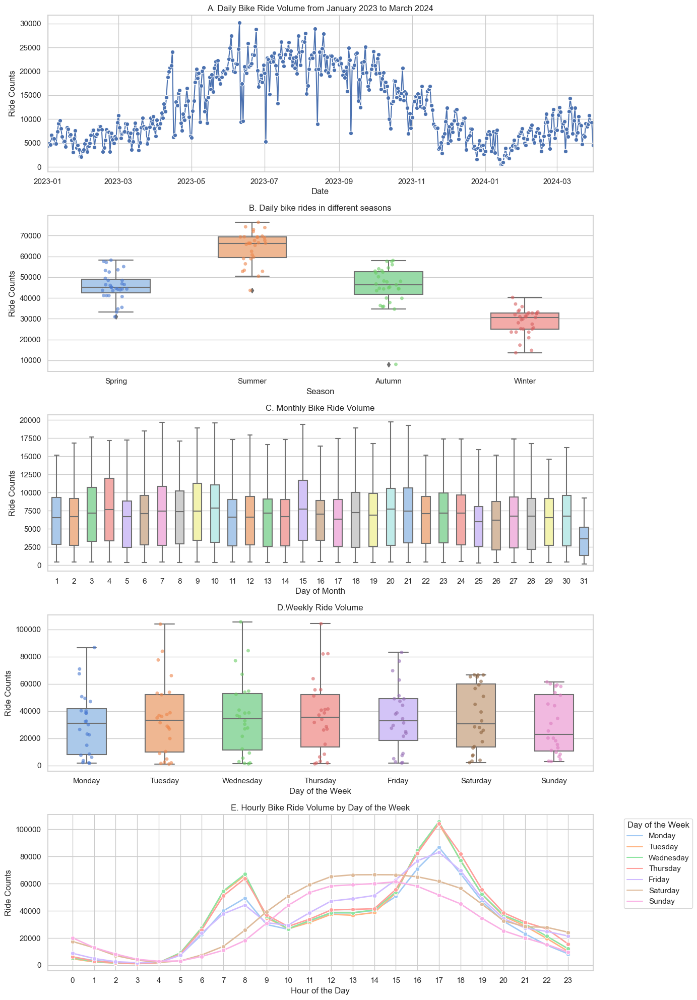

In [15]:
# read data
Time_demand=bike_final.copy()
Time_demand['started_at'] = pd.to_datetime(Time_demand['started_at'])
Time_demand['Date'] = Time_demand['started_at'].dt.date

sns.set(style="whitegrid")
fig, axes = plt.subplots(5, figsize=(14, 20))

# Daily Ride Volume from January 2023 to March 2024
year_demand = Time_demand.groupby('Date').size().reset_index(name='Counts')
sns.lineplot(x='Date', y='Counts',data=year_demand, ax=axes[0], marker='o', linestyle='-')
axes[0].set_xlim([pd.to_datetime('2023-01-01'), pd.to_datetime('2024-03-31')])
axes[0].set_title('A. Daily Bike Ride Volume from January 2023 to March 2024')
axes[0].set_xlabel('Date')
axes[0].set_ylabel('Ride Counts')

#Daily bike rides in different seasons
season_Demand=Time_demand.groupby(['Season','DayofMonth']).size().reset_index(name='Counts')
season_mapping = {0: 'Spring',1: 'Summer',2: 'Autumn',3: 'Winter'}
season_Demand['Season'] = season_Demand['Season'].map(season_mapping)
sns.boxplot(x='Season', y='Counts', data=season_Demand,ax=axes[1], palette="pastel", width=0.5)
sns.stripplot(x='Season', y='Counts', data=season_Demand, ax=axes[1], palette="muted",jitter=True,alpha=0.6)
axes[1].set_title('B. Daily bike rides in different seasons')
axes[1].set_xlabel('Season')
axes[1].set_ylabel('Ride Counts')

#Monthly Ride Volume
Time_demand_2023 = Time_demand[Time_demand['Year'] != 2024]
month_Demand=Time_demand_2023.groupby(['DayofMonth','Hour']).size().reset_index(name='Counts')
sns.boxplot(x='DayofMonth', y='Counts', data=month_Demand,ax=axes[2], palette="pastel", width=0.5)
axes[2].set_title('C. Monthly Bike Ride Volume')
axes[2].set_xlabel('Day of Month')
axes[2].set_ylabel('Ride Counts')

Week_day_Demand = Time_demand.groupby(['DayofWeek', 'Hour']).size().reset_index(name='Counts')
dayofweek_mapping = {1: 'Monday',2: 'Tuesday',3: 'Wednesday',4: 'Thursday',5: 'Friday',6: 'Saturday',7: 'Sunday'}
Week_day_Demand['DayofWeek'] = Week_day_Demand['DayofWeek'].map(dayofweek_mapping)
#Weekly Ride Volume
sns.boxplot(x='DayofWeek', y='Counts', data=Week_day_Demand,ax=axes[3], palette="pastel", width=0.5)
sns.stripplot(x='DayofWeek', y='Counts', data=Week_day_Demand, ax=axes[3], palette="muted",jitter=True,alpha=0.6)
axes[3].set_title('D.Weekly Ride Volume')
axes[3].set_xlabel('Day of the Week')
axes[3].set_ylabel('Ride Counts')

#Bicycle rides per hour per day
sns.lineplot( x='Hour', y='Counts', hue='DayofWeek', data=Week_day_Demand, ax=axes[4],
             palette='pastel', marker='o',linewidth=2)
axes[4].set_xticks(range(0, 24))
axes[4].set_title('E. Hourly Bike Ride Volume by Day of the Week')
axes[4].set_xlabel('Hour of the Day')
axes[4].set_ylabel('Ride Counts')
axes[4].legend(title="Day of the Week", bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.savefig('figure/Fig 3.png', dpi=300)
plt.show()

In [214]:
spatial = bike_final.copy()

In [234]:
#chicago city boundary
chicago=gpd.read_file('raw data/Chicago_CityBoundary/geo_export_9364be01-19fc-4f28-8f1f-64a1c42e8a42.shp')
chicago = chicago.to_crs(epsg =4326)

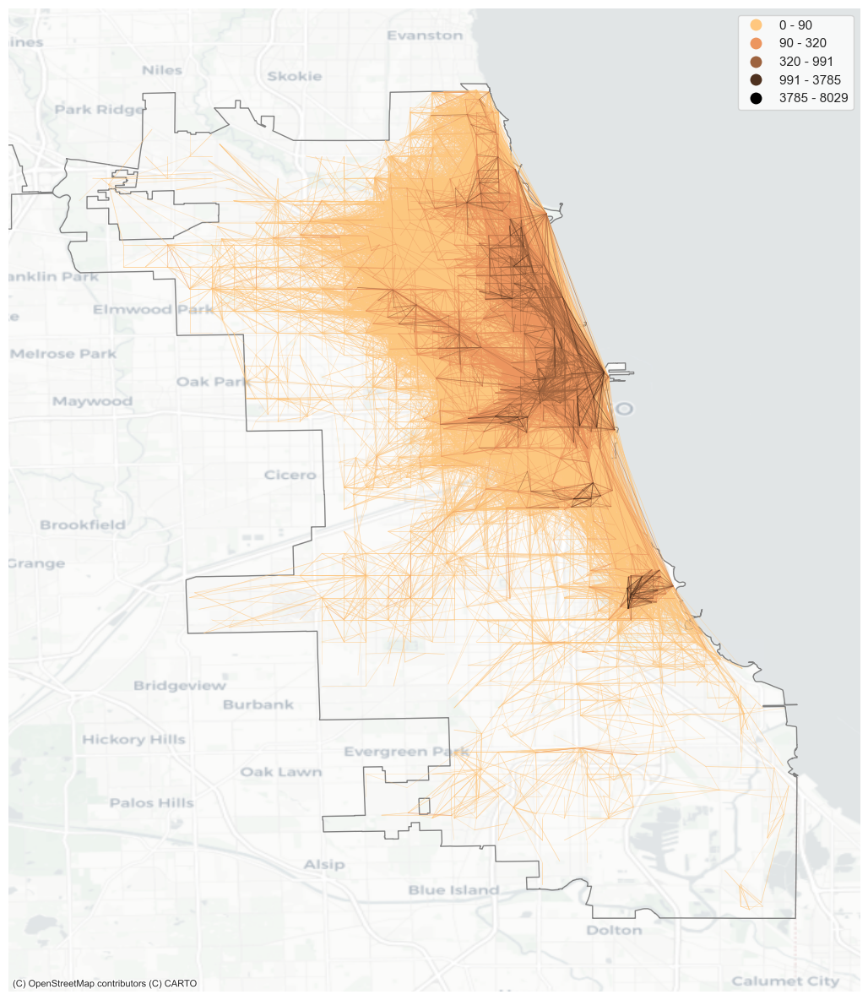

In [355]:
# read data
OD = spatial.groupby(['lat_start', 'lng_start', 'lat_end', 'lng_end']).size().reset_index(name='weight')
OD = trip_weights_gdf[trip_weights_gdf['weight']>5]
OD = OD.sort_values(by='weight', ascending=True).reset_index()

OD['geometry'] = OD.apply(lambda x: LineString([(x['lng_start'], x['lat_start']), (x['lng_end'], x['lat_end'])]), axis=1)
OD_gdf = gpd.GeoDataFrame(OD, geometry='geometry')
OD_gdf.set_crs(epsg=4326, inplace=True)

#
fig, ax = plt.subplots(figsize=(14, 12))
chicago.plot(ax=ax, edgecolor='gray', linewidth=1, facecolor='none')
scheme = mc.NaturalBreaks(OD['weight'], k=5)
geoplot.sankey(
    OD_gdf, hue='weight',
    cmap='copper_r', scheme=scheme, linewidth = 0.5,
    legend=True,alpha=0.4,ax=ax
)
# Add basemap using contextily
ctx.add_basemap(ax, crs='EPSG:4326', source=ctx.providers.CartoDB.Positron, alpha=0.7)

plt.tight_layout()
plt.savefig('figure/Fig 4.png', dpi=300)
plt.show()

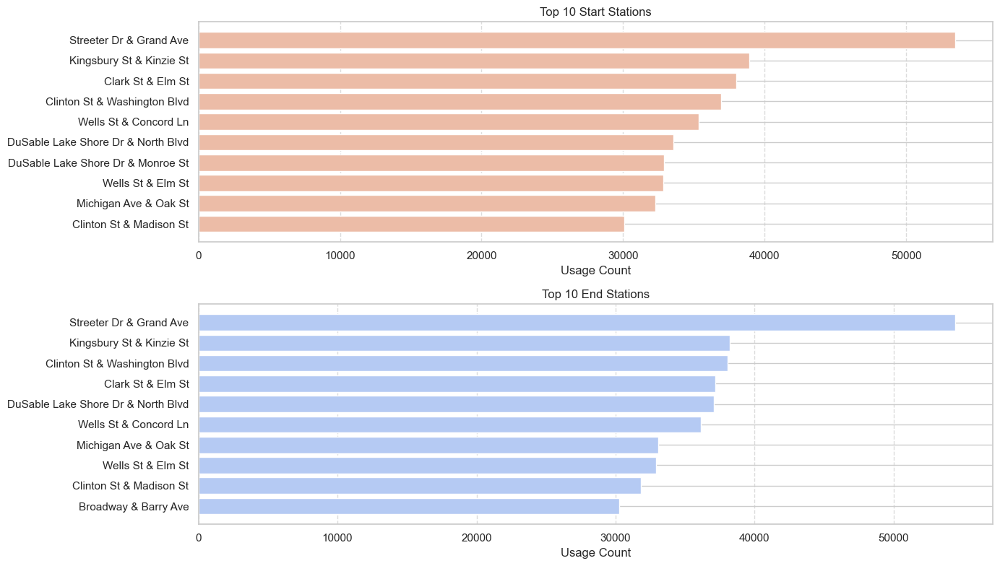

In [388]:
#Get start and end point data
startpoi = spatial.iloc[:, [2, 4, 5]].copy()
startpoi = startpoi.groupby(['start_station_name', 'lat_start', 'lng_start']).size().reset_index(name='ride_count')
endpoi = spatial.iloc[:, [3, 6, 7]].copy()
endpoi = endpoi.groupby(['end_station_name', 'lat_end', 'lng_end']).size().reset_index(name='ride_count')

top_10_start_stations = startpoi.sort_values(by='ride_count', ascending=True).tail(10)
top_10_end_stations = endpoi.sort_values(by='ride_count', ascending=True).tail(10)

fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(14, 8))
sns.set(style="whitegrid")

# Top 10 Start Stations
axes[0].barh(top_10_start_stations['start_station_name'], top_10_start_stations['ride_count'], color='#ECBCA7')
axes[0].set_title('Top 10 Start Stations')
axes[0].set_xlabel('Usage Count')
axes[0].grid(axis='x', linestyle='--', alpha=0.7)

# Top 10 End Stations
axes[1].barh(top_10_end_stations['end_station_name'], top_10_end_stations['ride_count'], color='#b5caf3')
axes[1].set_title('Top 10 End Stations')
axes[1].set_xlabel('Usage Count')
axes[1].grid(axis='x', linestyle='--', alpha=0.7)

#adjust the layout 
plt.tight_layout()
plt.savefig('figure/Fig 5 Top 10 Start and End Stations by Usage.png', dpi=300)
plt.show()

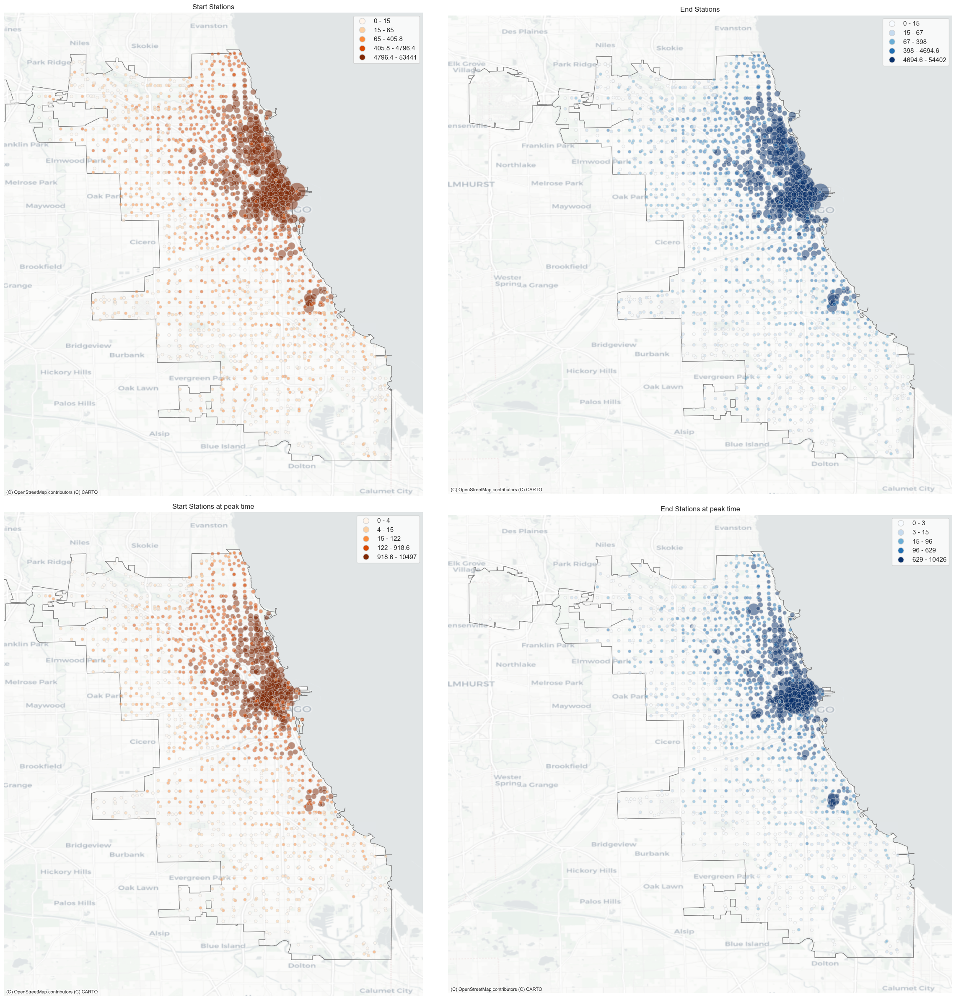

In [381]:
#read data and create geodataframe
start_gdf = gpd.GeoDataFrame(
    startpoi, geometry=gpd.points_from_xy(startpoi['lng_start'], startpoi['lat_start']))
start_gdf.set_crs(epsg=4326, inplace=True)
end_gdf = gpd.GeoDataFrame(
    endpoi, geometry=gpd.points_from_xy(endpoi['lng_end'], endpoi['lat_end']))
end_gdf.set_crs(epsg=4326, inplace=True)

rushhour_start = spatial[(spatial['Hour'] >= 7) & (spatial['Hour'] <= 9)].iloc[:, [2, 4, 5]]
rushhour_start = rushhour_start.groupby(['start_station_name', 'lat_start', 'lng_start']).size().reset_index(name='ride_count')
rushhour_start_gdf = gpd.GeoDataFrame(
    rushhour_start, geometry=gpd.points_from_xy(rushhour_start['lng_start'], rushhour_start['lat_start']))
rushhour_start_gdf.set_crs(epsg=4326, inplace=True)

rushhour_end = spatial[(spatial['Hour'] >= 7) & (spatial['Hour'] <= 9)].iloc[:, [3, 6, 7]]
rushhour_end = rushhour_end.groupby(['end_station_name', 'lat_end', 'lng_end']).size().reset_index(name='ride_count')
rushhour_end_gdf = gpd.GeoDataFrame(
    rushhour_end, geometry=gpd.points_from_xy(rushhour_end['lng_end'], rushhour_end['lat_end']))
rushhour_end_gdf.set_crs(epsg=4326, inplace=True)

fig, axs = plt.subplots(2, 2, figsize=(24, 24))

# Distribution of start stations
chicago.plot(ax=axs[0, 0], edgecolor='gray', linewidth=1, facecolor='none')
scheme_start = mc.Quantiles(start_gdf['ride_count'])
geoplot.pointplot(
    start_gdf,
    scale='ride_count', limits=(5, 30),
    hue='ride_count', 
    edgecolor='lightgray', linewidth=1, alpha=0.5,
    cmap='Oranges', scheme=scheme_start, 
    legend=True, ax=axs[0, 0])
axs[0, 0].set_title('Start Stations')
ctx.add_basemap(axs[0, 0], crs="EPSG:4326", source=ctx.providers.CartoDB.Positron, alpha=0.7)

# Distribution of end stations
chicago.plot(ax=axs[0, 1], edgecolor='gray', linewidth=1, facecolor='none')
scheme_end = mc.Quantiles(end_gdf['ride_count'])
geoplot.pointplot(
    end_gdf,
    scale='ride_count', limits=(5, 30),
    hue='ride_count', 
    edgecolor='lightgray', linewidth=1, alpha=0.5,
    cmap='Blues', scheme=scheme_end, 
    legend=True, ax=axs[0, 1])
axs[0, 1].set_title('End Stations')
ctx.add_basemap(axs[0, 1], crs="EPSG:4326", source=ctx.providers.CartoDB.Positron, alpha=0.7)

# Distribution of start stations during peak periods
chicago.plot(ax=axs[1, 0], edgecolor='gray', linewidth=1, facecolor='none')
scheme_start = mc.Quantiles(rushhour_start_gdf['ride_count'])
geoplot.pointplot(
    rushhour_start_gdf,
    scale='ride_count', limits=(5, 30),
    hue='ride_count', 
    edgecolor='lightgray', linewidth=1, alpha=0.5,
    cmap='Oranges', scheme=scheme_start, 
    legend=True, ax=axs[1, 0])
axs[1, 0].set_title('Start Stations at peak time')
ctx.add_basemap(axs[1, 0], crs="EPSG:4326", source=ctx.providers.CartoDB.Positron, alpha=0.7)

# Distribution of end stations during peak periods
chicago.plot(ax=axs[1, 1], edgecolor='gray', linewidth=1, facecolor='none')
scheme_end = mc.Quantiles(rushhour_end_gdf['ride_count'])
geoplot.pointplot(
    rushhour_end_gdf,
    scale='ride_count', limits=(5, 30),
    hue='ride_count', 
    edgecolor='lightgray', linewidth=1, alpha=0.5,
    cmap='Blues', scheme=scheme_end, 
    legend=True, ax=axs[1, 1])
axs[1, 1].set_title('End Stations at peak time')
ctx.add_basemap(axs[1, 1], crs="EPSG:4326", source=ctx.providers.CartoDB.Positron, alpha=0.7)


plt.tight_layout()
plt.savefig('figure/Fig 6 Chicago Bike Share Station Usage Map_Start and End Stations.png', dpi=300)
plt.show()

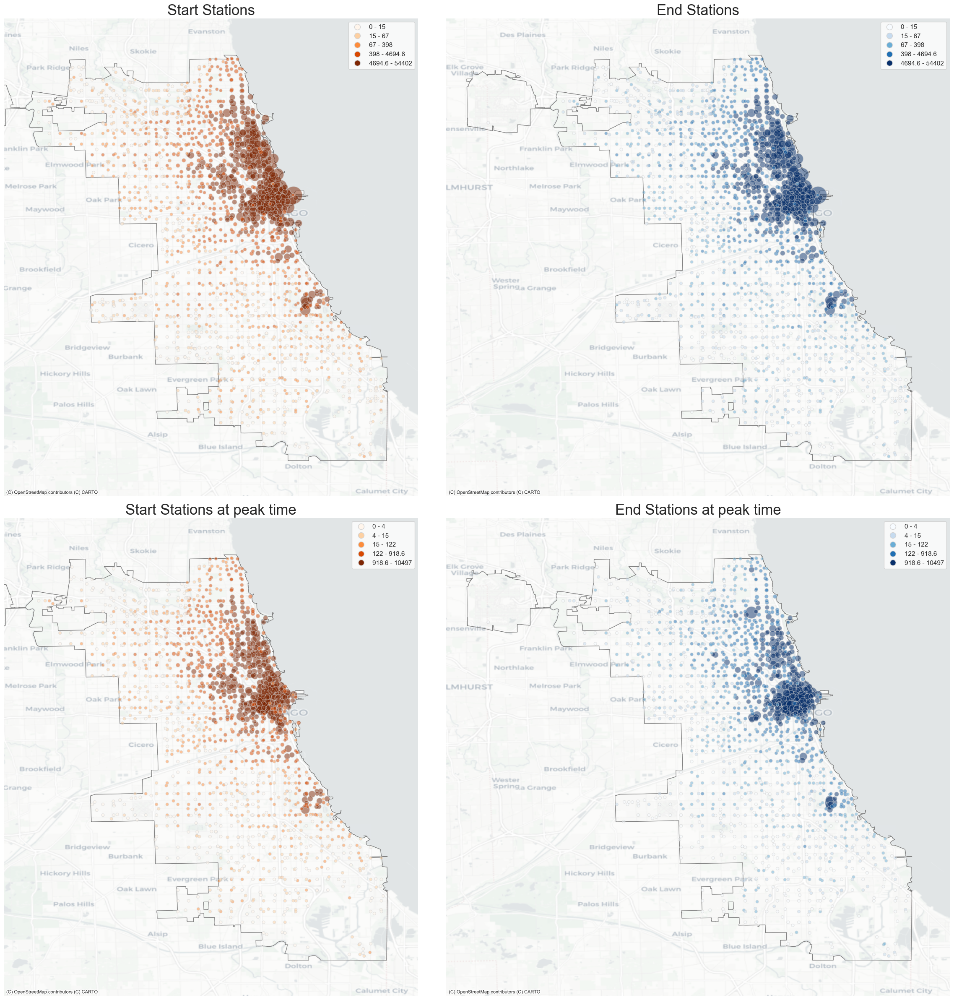

In [384]:
#read data and create geodataframe
start_gdf = gpd.GeoDataFrame(
    startpoi, geometry=gpd.points_from_xy(startpoi['lng_start'], startpoi['lat_start']))
start_gdf.set_crs(epsg=4326, inplace=True)
end_gdf = gpd.GeoDataFrame(
    endpoi, geometry=gpd.points_from_xy(endpoi['lng_end'], endpoi['lat_end']))
end_gdf.set_crs(epsg=4326, inplace=True)

rushhour_start = spatial[(spatial['Hour'] >= 7) & (spatial['Hour'] <= 9)].iloc[:, [2, 4, 5]]
rushhour_start = rushhour_start.groupby(['start_station_name', 'lat_start', 'lng_start']).size().reset_index(name='ride_count')
rushhour_start_gdf = gpd.GeoDataFrame(
    rushhour_start, geometry=gpd.points_from_xy(rushhour_start['lng_start'], rushhour_start['lat_start']))
rushhour_start_gdf.set_crs(epsg=4326, inplace=True)

rushhour_end = spatial[(spatial['Hour'] >= 7) & (spatial['Hour'] <= 9)].iloc[:, [3, 6, 7]]
rushhour_end = rushhour_end.groupby(['end_station_name', 'lat_end', 'lng_end']).size().reset_index(name='ride_count')
rushhour_end_gdf = gpd.GeoDataFrame(
    rushhour_end, geometry=gpd.points_from_xy(rushhour_end['lng_end'], rushhour_end['lat_end']))
rushhour_end_gdf.set_crs(epsg=4326, inplace=True)

fig, axs = plt.subplots(2, 2, figsize=(24, 24))

scheme = mc.Quantiles(end_gdf['ride_count'])
# Distribution of start stations
chicago.plot(ax=axs[0, 0], edgecolor='gray', linewidth=1, facecolor='none')
geoplot.pointplot(
    start_gdf,
    scale='ride_count', limits=(5, 30),
    hue='ride_count', 
    edgecolor='lightgray', linewidth=1, alpha=0.5,
    cmap='Oranges', scheme=scheme, 
    legend=True, ax=axs[0, 0])
axs[0, 0].set_title('Start Stations',fontsize=25)
ctx.add_basemap(axs[0, 0], crs="EPSG:4326", source=ctx.providers.CartoDB.Positron, alpha=0.7)

# Distribution of end stations
chicago.plot(ax=axs[0, 1], edgecolor='gray', linewidth=1, facecolor='none')
geoplot.pointplot(
    end_gdf,
    scale='ride_count', limits=(5, 30),
    hue='ride_count', 
    edgecolor='lightgray', linewidth=1, alpha=0.5,
    cmap='Blues', scheme=scheme, 
    legend=True, ax=axs[0, 1])
axs[0, 1].set_title('End Stations',fontsize=25)
ctx.add_basemap(axs[0, 1], crs="EPSG:4326", source=ctx.providers.CartoDB.Positron, alpha=0.7)

scheme_rush = mc.Quantiles(rushhour_start_gdf['ride_count'])
# Distribution of start stations during peak periods
chicago.plot(ax=axs[1, 0], edgecolor='gray', linewidth=1, facecolor='none')
geoplot.pointplot(
    rushhour_start_gdf,
    scale='ride_count', limits=(5, 30),
    hue='ride_count', 
    edgecolor='lightgray', linewidth=1, alpha=0.5,
    cmap='Oranges', scheme=scheme_rush, 
    legend=True, ax=axs[1, 0])
axs[1, 0].set_title('Start Stations at peak time',fontsize=25)
ctx.add_basemap(axs[1, 0], crs="EPSG:4326", source=ctx.providers.CartoDB.Positron, alpha=0.7)

# Distribution of end stations during peak periods
chicago.plot(ax=axs[1, 1], edgecolor='gray', linewidth=1, facecolor='none')
geoplot.pointplot(
    rushhour_end_gdf,
    scale='ride_count', limits=(5, 30),
    hue='ride_count', 
    edgecolor='lightgray', linewidth=1, alpha=0.5,
    cmap='Blues', scheme=scheme_rush, 
    legend=True, ax=axs[1, 1])
axs[1, 1].set_title('End Stations at peak time',fontsize=25)
ctx.add_basemap(axs[1, 1], crs="EPSG:4326", source=ctx.providers.CartoDB.Positron, alpha=0.7)


plt.tight_layout()
plt.savefig('figure/Fig 6.png', dpi=300)
plt.show()

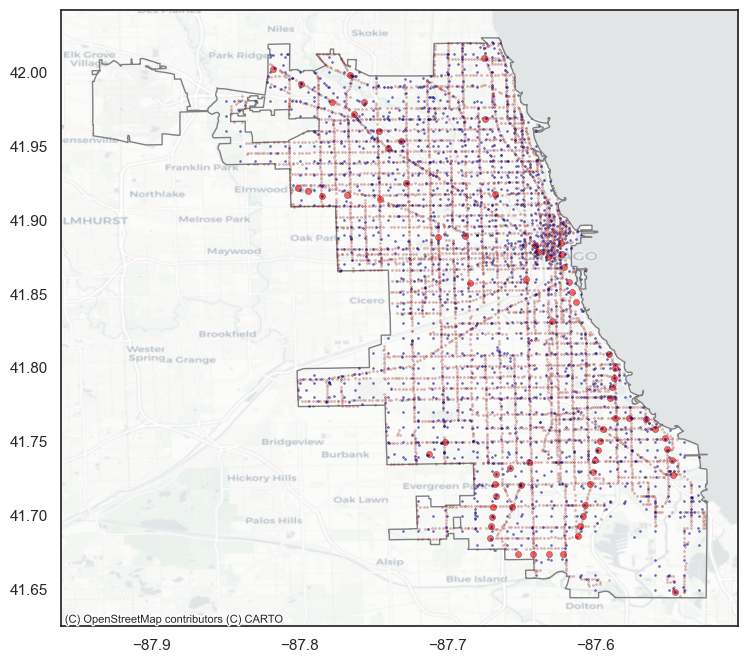

In [584]:
#Bus stops
Bus_stop = pd.read_csv("raw data/BusStop_unique.csv")
BusStop_gdf = gpd.GeoDataFrame(
    Bus_stop, geometry=gpd.points_from_xy(Bus_stop['longitude'], Bus_stop['latitude']))
BusStop_gdf.set_crs(epsg=4326, inplace=True)

MetroStation = pd.read_csv("raw data/MetroStation_unique.csv")
MetroStation_gdf = gpd.GeoDataFrame(
    MetroStation, geometry=gpd.points_from_xy(MetroStation['longitude'], MetroStation['latitude']))
MetroStation_gdf.set_crs(epsg=4326, inplace=True)

#Station Distribution Map
fig, ax = plt.subplots(figsize=(12,8))
chicago.plot(ax=ax, edgecolor='gray', linewidth=1, facecolor='none')
BusStop_gdf.plot(ax=ax,
                    markersize=2, color='red', alpha=0.3,
                    edgecolor='black', linewidth=0.3)
MetroStation_gdf.plot(ax=ax,
                    markersize=20, color='red', alpha=0.6,
                    edgecolor='black', linewidth=0.3)
start_gdf.plot(ax=ax,
                    markersize=2, color='blue', alpha=0.6,
                    edgecolor='black', linewidth=0.3)


# Add basemap
ctx.add_basemap(ax, crs="EPSG:4326", source=ctx.providers.CartoDB.Positron, alpha=0.7)
plt.savefig('figure/Fig 7.png', dpi=300)
plt.show()

In [711]:
#heat map
#read data
map_center = [startpoi['lat_start'].mean(), startpoi['lng_start'].mean()]
map = folium.Map(location=map_center, zoom_start=12)
heat_data = startpoi[['lat_start', 'lng_start', 'ride_count']].values.tolist()
HeatMap(heat_data).add_to(map)

# bus station
for index, row in Bus_stop.iterrows():
    folium.CircleMarker(
        location=(row['latitude'], row['longitude']),
        radius=2,  
        color='blue',
        fill=False,
        popup=row['Station_name']  
    ).add_to(map)
# metro station
for index, row in MetroStation.iterrows():
    folium.CircleMarker(
        location=(row['latitude'], row['longitude']),
        radius=5,  # 控制圆形标记的大小
        color='red',  # 圆形标记的颜色
        fill=False,
        popup=row['Station_name'] 
    ).add_to(map)

map.save('figure/Fig 7 heatmap_with_ride_count.html')
map

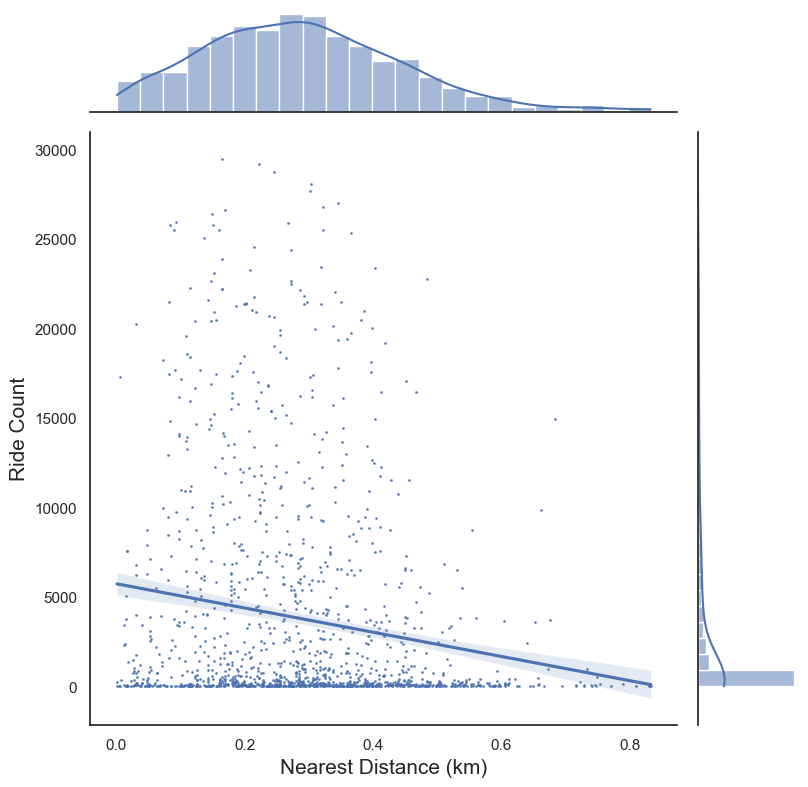

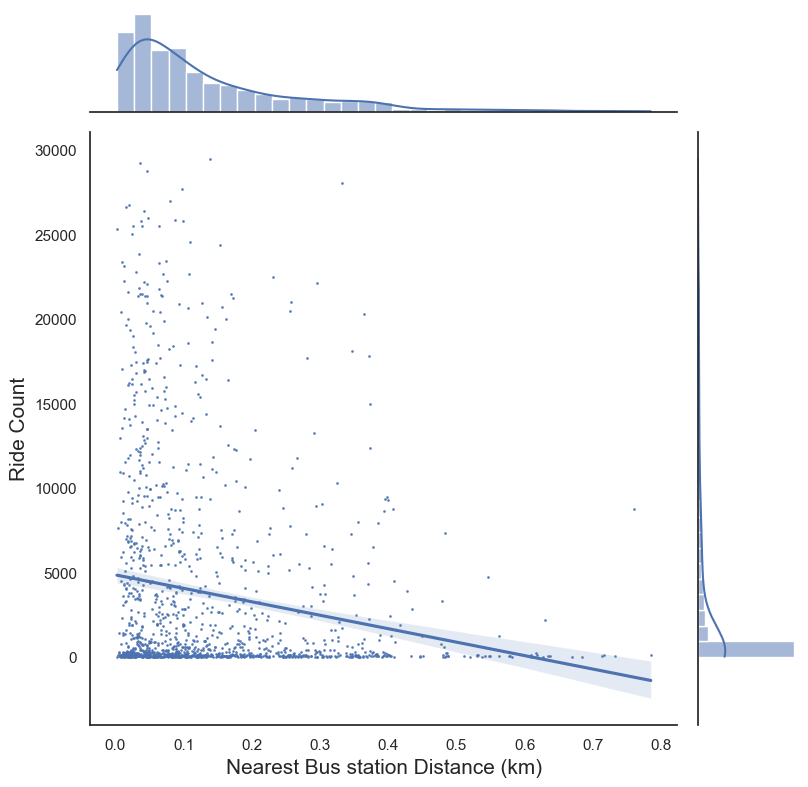

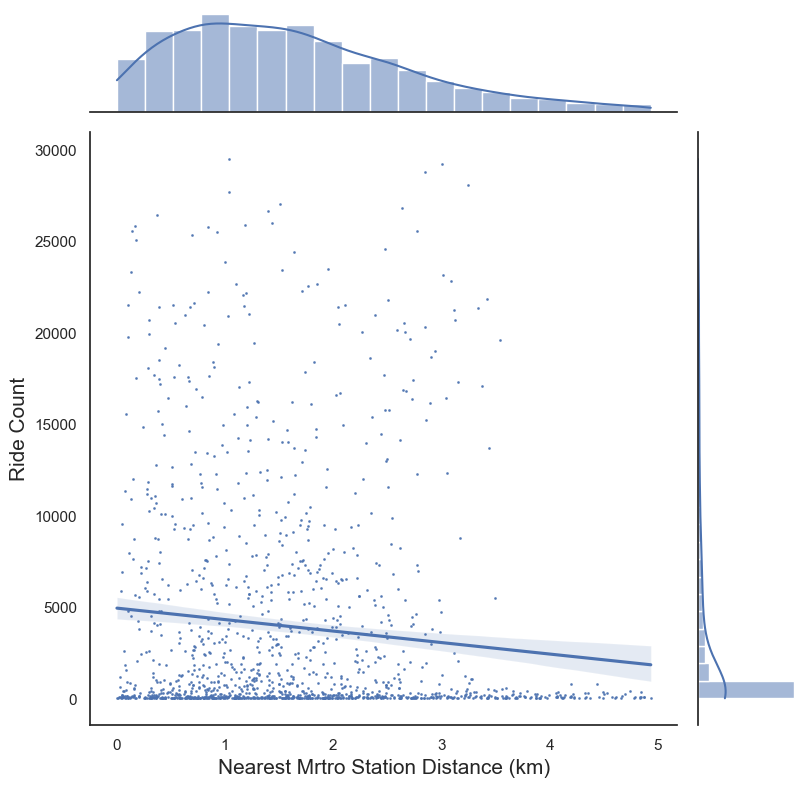

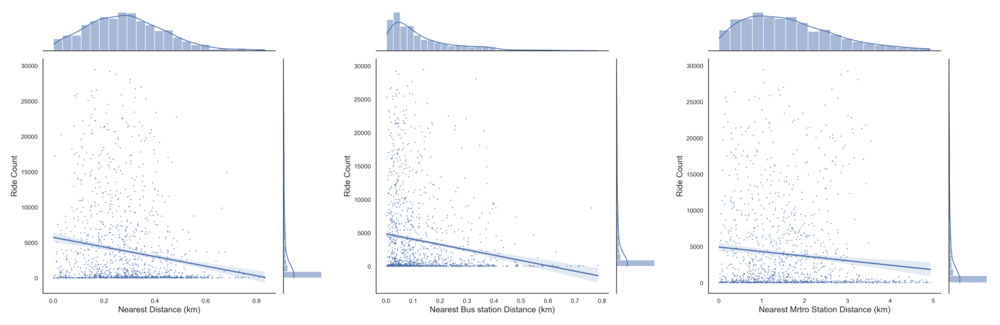

In [596]:
#read data
POI = spatial.iloc[:, [2, 19, 20, 21,11]].copy()
POI = POI.groupby(['start_station_name','nearest_distance_km','nearest_metro_distance_km','nearest_bus_distance_km']).size().reset_index(name='ride_count')

POI_bike = POI[(POI['nearest_distance_km']<1) & (POI['ride_count']>20) & (POI['ride_count']<30000)]
P1 = sns.jointplot(x="nearest_distance_km", y="ride_count", kind="reg", scatter_kws={"s": 1}, data=POI_bike, height=8)
P1.set_axis_labels('Nearest Distance (km)', 'Ride Count', fontsize=15)
P1.savefig('figure/Fig 8.1.png', dpi=300)

POI_bus = POI[(POI['nearest_bus_distance_km']< 0.8) & (POI['ride_count']>20) & (POI['ride_count']<30000)]
P2 = sns.jointplot(x="nearest_bus_distance_km", y="ride_count", kind="reg", scatter_kws={"s": 1}, data=POI_bus, height=8)
P2.set_axis_labels('Nearest Bus station Distance (km)', 'Ride Count', fontsize=15)
P2.savefig('figure/Fig 8.2.png', dpi=300)

POI_metro = POI[(POI['nearest_metro_distance_km']<5) & (POI['ride_count']>20) & (POI['ride_count']<30000)]
P3 = sns.jointplot(x="nearest_metro_distance_km", y="ride_count", kind="reg", scatter_kws={"s": 1}, data=POI_metro, height=8)
P3.set_axis_labels('Nearest Mrtro Station Distance (km)', 'Ride Count', fontsize=15)
P3.savefig('figure/Fig 8.3.png', dpi=300)

folder_path = 'figure'
image_filenames = ['Fig 8.1.png', 'Fig 8.2.png', 'Fig 8.3.png']
image_paths = [os.path.join(folder_path, filename) for filename in image_filenames]

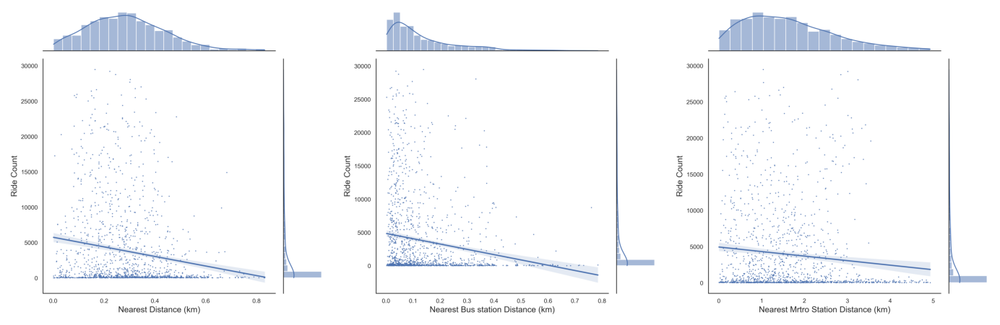

In [595]:
folder_path = 'figure'
image_filenames = ['Fig 8.1.png', 'Fig 8.2.png', 'Fig 8.3.png']
image_paths = [os.path.join(folder_path, filename) for filename in image_filenames]


fig, axes = plt.subplots(1, 3, figsize=(14, 6))
for ax, image_path in zip(axes, image_paths):
    # 使用 PIL 加载图片
    image = Image.open(image_path)
    # 在子图上显示图片
    ax.imshow(image)
    # 移除坐标轴
    ax.axis('off')
plt.subplots_adjust(wspace=0.05, hspace=0)

plt.tight_layout()
plt.savefig('figure/Fig 8.png', dpi=300)
plt.show()

In [705]:
#Weather
Wea = bike_final.iloc[:, [8, 9, 11, 14, 22, 23, 24, 25, 26, 27]].copy()
Wea = Wea.groupby(list(Wea.columns)).size().reset_index(name='Count')
Wea = Wea.sort_values(by='Count', ascending=True).reset_index(drop=True)
Wea

,Year,Month,DayofMonth,Hour,Temp,Atemp,Prec,Humidity,Windspeed,AtmPressure,Count
0,2023,1,3,3,4.38,5.052500,2.13,98.06,7.69,98.44,1
1,2023,2,1,2,-9.81,-5.291667,0.00,94.75,6.79,100.54,1
2,2024,1,15,1,-17.27,-15.286667,0.03,100.00,7.80,100.24,1
3,2024,3,5,2,7.48,5.021250,4.30,100.00,7.64,98.79,1
4,2024,1,23,2,0.84,1.207500,1.14,95.94,3.71,100.36,1
...,...,...,...,...,...,...,...,...,...,...,...
10929,2023,8,16,17,24.06,21.498750,0.00,62.38,5.08,99.01,2946
10930,2023,8,29,17,23.03,21.828333,0.00,74.12,7.28,99.02,2951
10931,2023,8,1,17,26.69,23.703333,0.00,53.00,0.89,99.82,2989
10932,2023,10,4,17,21.93,21.443333,0.68,81.31,4.68,99.17,2991


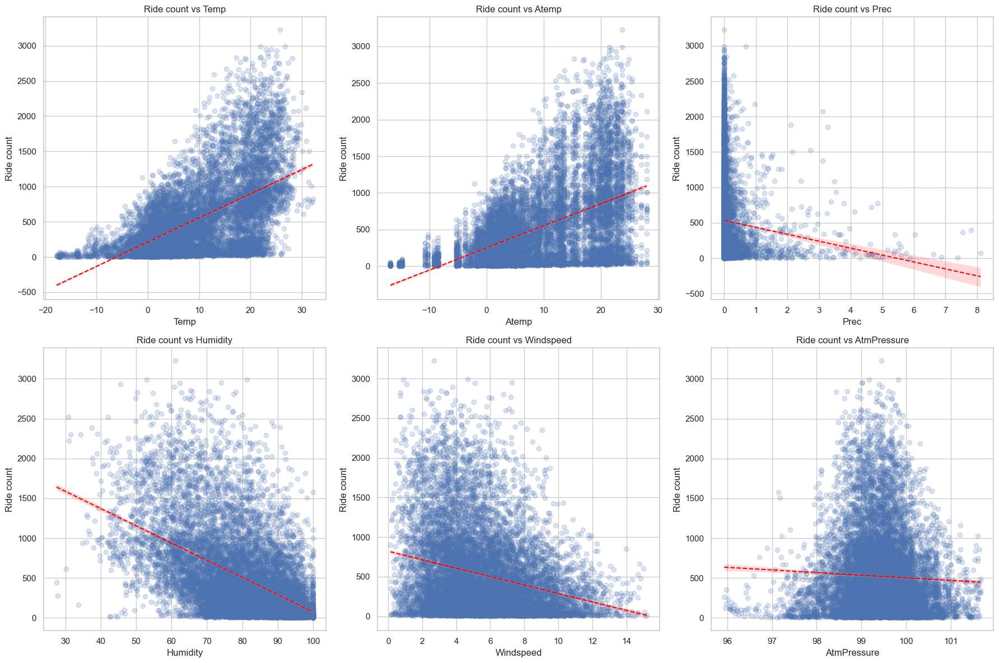

In [706]:
fig, axs = plt.subplots(2, 3, figsize=(18, 12))
axs = axs.ravel()

# 遍历指定的列（这里假设是第4到第10列）
for i, column in enumerate(Wea.columns[4:10], 4):
    sns.regplot(x=column, y="Count", data=Wea, ax=axs[i-4], 
                scatter_kws={'alpha': 0.2}, line_kws={'lw': 1.5,'color': 'red','linestyle': '--'})
    axs[i-4].set_xlabel(column)
    axs[i-4].set_ylabel("Ride count")
    axs[i-4].set_title(f'Ride count vs {column}')

plt.subplots_adjust(hspace=0.5)

plt.tight_layout()
plt.savefig('figure/Fig 9.png', dpi=300)
plt.show()

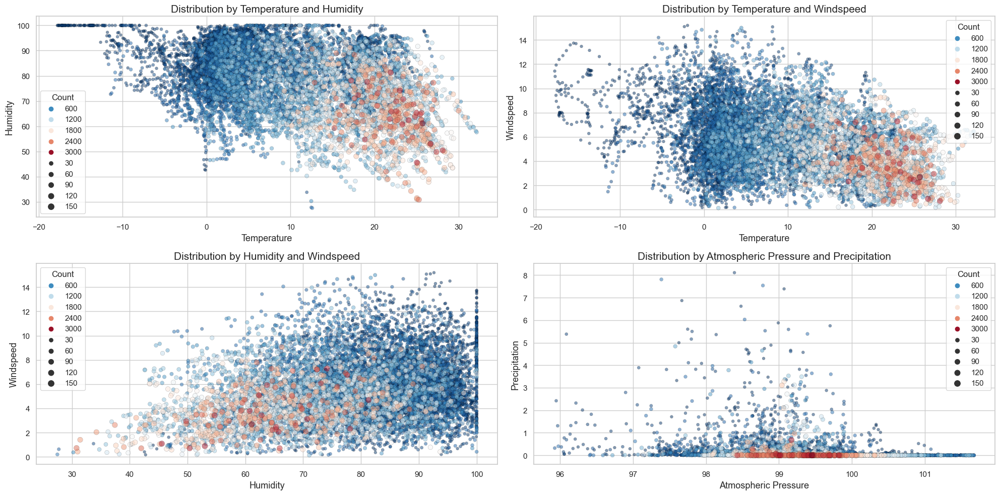

In [712]:
sns.set(style="whitegrid")
fig, axes = plt.subplots(2, 2, figsize=(20, 10))

# 第一个子图: 温度 vs. 湿度
sns.scatterplot(ax=axes[0, 0], x='Temp', y='Humidity', size=Wea['Count']/20,
                hue='Count', palette='RdBu_r', edgecolor='black', linewidth=0.2,
                alpha=0.5, data=Wea)
axes[0, 0].set_title('Distribution by Temperature and Humidity', fontsize=15)
axes[0, 0].set_xlabel('Temperature', fontsize=13)
axes[0, 0].set_ylabel('Humidity', fontsize=13)

# 第二个子图: 温度 vs. 风速
sns.scatterplot(ax=axes[0, 1], x='Temp', y='Windspeed', size=Wea['Count']/20,
                hue='Count', palette='RdBu_r', edgecolor='black', linewidth=0.2,
                alpha=0.5, data=Wea)
axes[0, 1].set_title('Distribution by Temperature and Windspeed', fontsize=15)
axes[0, 1].set_xlabel('Temperature', fontsize=13)
axes[0, 1].set_ylabel('Windspeed', fontsize=13)

# 第三个子图: 湿度 vs. 风速
sns.scatterplot(ax=axes[1, 0], x='Humidity', y='Windspeed', size=Wea['Count']/20,
                hue='Count', palette='RdBu_r', edgecolor='black', linewidth=0.2,
                alpha=0.5, data=Wea)
axes[1, 0].set_title('Distribution by Humidity and Windspeed', fontsize=15)
axes[1, 0].set_xlabel('Humidity', fontsize=13)
axes[1, 0].set_ylabel('Windspeed', fontsize=13)

# 第四个子图: 气压 vs. 降水量
sns.scatterplot(ax=axes[1, 1], x='AtmPressure', y='Prec', size=Wea['Count']/20,
                hue='Count', palette='RdBu_r', edgecolor='black', linewidth=0.2,
                alpha=0.5, data=Wea)
axes[1, 1].set_title('Distribution by Atmospheric Pressure and Precipitation', fontsize=15)
axes[1, 1].set_xlabel('Atmospheric Pressure', fontsize=13)
axes[1, 1].set_ylabel('Precipitation', fontsize=13)

# 优化图形显示
plt.tight_layout()
plt.savefig('figure/Fig 10.png', dpi=300)
plt.show()